In [14]:
import numpy as np
import pandas as pd
import seaborn as sns
from scipy.stats import norm
import matplotlib.pyplot as plt
import math
import plotly.express as px
import requests

import matplotlib.pyplot as plt
import matplotlib.patches as patches

import pandasql as ps
import altair as alt

In [2]:
repo_url='https://raw.githubusercontent.com/angelnmara/geojson/master/mexicoHigh.json'
mx_regions_geo = requests.get(repo_url).json()

In [3]:
entidades = {'Estado':['Aguascalientes','Baja California','Baja California Sur','Campeche','Chiapas','Chihuahua',
                        'Coahuila','Colima','Ciudad de México','Durango','Guanajuato','Guerrero','Hidalgo',
                       'Jalisco','México','Michoacán','Morelos','Nayarit','Nuevo León','Oaxaca','Puebla','Querétaro','Quintana Roo',
                       'San Luis Potosí','Sinaloa','Sonora','Tabasco','Tamaulipas','Tlaxcala','Veracruz','Yucatán','Zacatecas'],
             'Entidad':[1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32]}

In [4]:
df_ent = pd.DataFrame(entidades)

In [75]:
df_ent

,Estado,Entidad
0,Aguascalientes,1
1,Baja California,2
2,Baja California Sur,3
3,Campeche,4
4,Chiapas,5
5,Chihuahua,6
6,Coahuila,7
7,Colima,8
8,Ciudad de México,9
9,Durango,10


In [5]:
data = pd.read_csv('residente_paren_1_limpio.csv')
data

,Unnamed: 0,PAREN,SEXO,EDAD,P3_7,NIVEL,GRADO,P3_9_1,P3_9_2,P3_9_3,UPM_DIS,EST_DIS,DOMINIO,TLOC,ESTRATO,ENT,code
0,0,1,2,41,2.0,10.0,2.0,1.0,1.0,1.0,1,7,U,1,3,1,1000231
1,1,1,1,46,2.0,6.0,3.0,2.0,1.0,1.0,1,7,U,1,3,1,1000232
2,2,1,2,50,2.0,8.0,4.0,1.0,1.0,1.0,1,7,U,1,3,1,1000233
3,3,1,1,56,2.0,2.0,6.0,2.0,1.0,1.0,1,7,U,1,3,1,1000234
4,4,1,1,71,2.0,8.0,5.0,2.0,2.0,1.0,1,7,U,1,3,1,1000235
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
59280,59280,1,2,52,2.0,3.0,3.0,2.0,2.0,2.0,8235,337,R,4,1,32,326079415
59281,59281,1,1,42,2.0,6.0,1.0,2.0,2.0,1.0,8235,337,R,4,1,32,326079416
59282,59282,1,1,66,2.0,2.0,6.0,2.0,2.0,2.0,8235,337,R,4,1,32,326079418
59283,59283,1,1,73,2.0,2.0,3.0,2.0,2.0,2.0,8235,337,R,4,1,32,326079419


In [6]:
data.drop(data.columns[0],axis=1,inplace=True)

In [28]:
data['NIVEL']=data['NIVEL'].map({0:0,
                                    1:1, 
                                    2:2, 
                                    3:3, 
                                    4:5,
                                    5:3,
                                    6:4,
                                    8:5,
                                    9:6,
                                    10:6,
                                    11:7,
                                    7:99,
                                    99:99}).astype(int)


In [29]:
data.describe()

,PAREN,SEXO,EDAD,P3_7,NIVEL,GRADO,P3_9_1,P3_9_2,P3_9_3,UPM_DIS,EST_DIS,TLOC,ESTRATO,ENT,code
count,59285.0,59285.000000,59285.000000,59285.000000,59285.000000,59285.000000,59285.000000,59285.000000,59285.000000,59285.000000,59285.000000,59285.000000,59285.000000,59285.000000,5.928500e+04
mean,1.0,1.313351,50.445222,1.981176,5.543881,3.393877,1.771274,1.382154,1.200607,4280.443080,167.319558,2.194299,2.188766,16.500329,6.042729e+07
std,0.0,0.463860,15.958583,0.135905,15.171184,1.656738,0.773726,0.662727,0.531245,2358.039616,99.950863,1.238174,0.836415,9.220682,8.645186e+07
min,1.0,1.000000,14.000000,1.000000,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000231e+06
25%,1.0,1.000000,38.000000,2.000000,2.000000,3.000000,1.000000,1.000000,1.000000,2219.000000,80.000000,1.000000,2.000000,9.000000,1.101487e+07
50%,1.0,1.000000,49.000000,2.000000,3.000000,3.000000,2.000000,1.000000,1.000000,4259.000000,162.000000,2.000000,2.000000,16.000000,2.201714e+07
75%,1.0,2.000000,62.000000,2.000000,4.000000,5.000000,2.000000,2.000000,1.000000,6286.000000,258.000000,3.000000,3.000000,24.000000,4.013232e+07
max,1.0,2.000000,98.000000,2.000000,99.000000,9.000000,9.000000,9.000000,9.000000,8235.000000,341.000000,4.000000,4.000000,32.000000,3.260794e+08


In [30]:
q1=ps.sqldf("SELECT df_ent.Estado as Estados, COUNT(data.ENT) as Registros FROM data INNER JOIN df_ent ON data.ENT=df_ent.Entidad GROUP BY Estados ORDER BY Registros DESC", locals())
q1.head()

,Estados,Registros
0,Tlaxcala,1935
1,Guanajuato,1930
2,Michoacán,1908
3,Tabasco,1900
4,San Luis Potosí,1896


In [117]:
q1.Registros.mean()

1852.65625

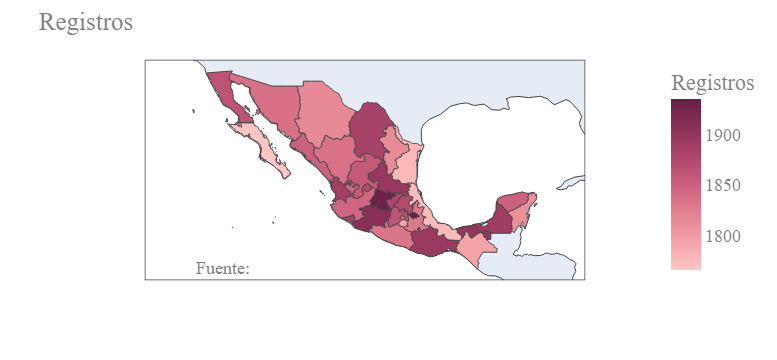

In [116]:
#figuras
fig = px.choropleth(data_frame=q1,
                  geojson=mx_regions_geo,
                    locations = 'Estados',
                  featureidkey='properties.name',
                  color='Registros',
                  color_continuous_scale="burg",)
fig.update_geos(showcountries=False,showcoastlines=True,showland=True,fitbounds="locations")

fig.update_layout(title_text = 'Registros', 
                  font=dict(family="Ubuntu",size=18,color="#7f7f7f"),
                 annotations = [dict(x=0.2,y=0,xref='paper',yref='paper',text='Fuente:',showarrow=False)]
                 )
fig.show()

In [10]:
q2=ps.sqldf("SELECT df_ent.Estado as Estados, COUNT(data.SEXO) as Hombres FROM data INNER JOIN df_ent ON data.ENT=df_ent.Entidad WHERE data.SEXO = '1' GROUP BY Estados ORDER BY Hombres DESC", locals())
q2.head()

,Estados,Hombres
0,Coahuila,1420
1,Tlaxcala,1365
2,Guanajuato,1351
3,Nuevo León,1346
4,Hidalgo,1335


In [44]:
q3=ps.sqldf("SELECT df_ent.Estado as Estados, COUNT(data.SEXO) as Mujeres FROM data INNER JOIN df_ent ON data.ENT=df_ent.Entidad WHERE data.SEXO = '2' GROUP BY Estados ORDER BY Mujeres DESC", locals())
q3.head()

,Estados,Mujeres
0,Ciudad de México,687
1,Sinaloa,651
2,Morelos,639
3,Michoacán,630
4,Durango,630


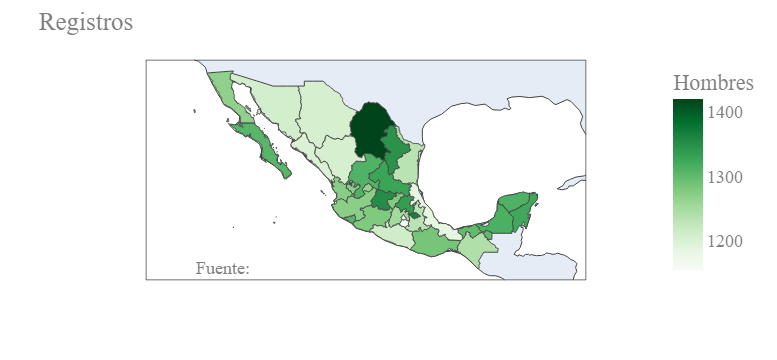

In [118]:
fig = px.choropleth(data_frame=q2,
                  geojson=mx_regions_geo,
                    locations = 'Estados',
                  featureidkey='properties.name',
                  color='Hombres',
                  color_continuous_scale="greens",)
fig.update_geos(showcountries=False,showcoastlines=True,showland=True,fitbounds="locations")

fig.update_layout(title_text = 'Registros', 
                  font=dict(family="Ubuntu",size=18,color="#7f7f7f"),
                 annotations = [dict(x=0.2,y=0,xref='paper',yref='paper',text='Fuente:',showarrow=False)]
                 )
fig.show()

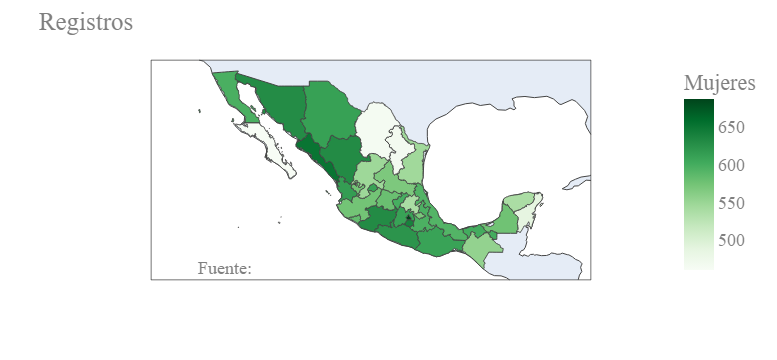

In [119]:
fig = px.choropleth(data_frame=q3,
                  geojson=mx_regions_geo,
                    locations = 'Estados',
                  featureidkey='properties.name',
                  color='Mujeres',
                  color_continuous_scale="greens",)
fig.update_geos(showcountries=False,showcoastlines=True,showland=True,fitbounds="locations")

fig.update_layout(title_text = 'Registros', 
                  font=dict(family="Ubuntu",size=18,color="#7f7f7f"),
                 annotations = [dict(x=0.2,y=0,xref='paper',yref='paper',text='Fuente:',showarrow=False)]
                 )
fig.show()

In [73]:
alt.data_transformers.disable_max_rows()

DataTransformerRegistry.enable('default')

In [113]:
chart2 = alt.Chart(data).mark_bar().encode(y='NIVEL:N',x=alt.X('count(SEXO):Q').title('Jefes por sexo'),
                                           color='SEXO:N',
                                           order=alt.Order("SEXO").sort("ascending")
)

#-------------------------------------------------------

bar = alt.Chart(data).mark_bar().encode(alt.Y('NIVEL', type= 'nominal').title('Nivel académico'),
                                  alt.X('count(SEXO)', type='quantitative').title('Jefes del hogar'))

text = bar.mark_text(align="left",baseline="middle",dx=9).encode(text="count(SEXO)")

 
    
bar + text|chart2

alt.HConcatChart(...)

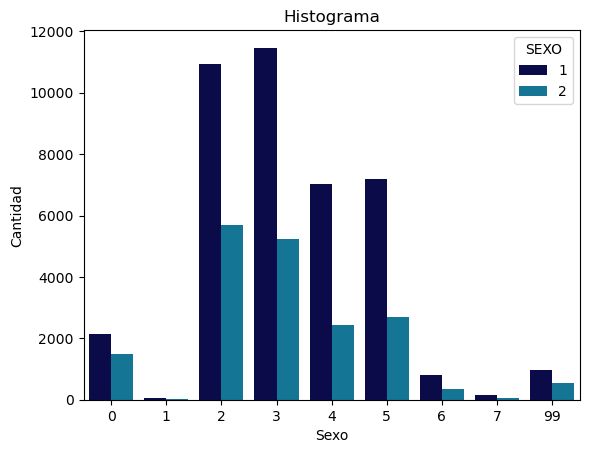

In [120]:
grafico = sns.countplot( x='NIVEL' ,  palette = 'ocean', data = data,  hue='SEXO')
grafico.set(title = 'Histograma',
           xlabel ='Sexo', ylabel = 'Cantidad')
plt.show()

##Este gráfico no debe ser utilizado, existe para comparar con la otra librería

In [110]:
alt.Chart(data).mark_bar().encode(
    x=alt.X('count()').title('Cantidad'),
    y=alt.Y('EDAD:Q').bin(maxbins=9).title('Edad'),
    color='NIVEL:N'
).properties(
    height=250,
    width=300
)

alt.Chart(...)

# Filtramos por estado, para este caso realizamos con Jalisco

In [76]:
q4=ps.sqldf("SELECT * FROM data INNER JOIN df_ent ON data.ENT=df_ent.Entidad WHERE df_ent.Entidad = '14'", locals())
q4.head()

,PAREN,SEXO,EDAD,P3_7,NIVEL,GRADO,P3_9_1,P3_9_2,P3_9_3,UPM_DIS,EST_DIS,DOMINIO,TLOC,ESTRATO,ENT,code,Estado,Entidad
0,1,1,87,2.0,5,4.0,1.0,1.0,1.0,3484,137,U,1,4,14,14000721,Jalisco,14
1,1,2,82,2.0,2,6.0,2.0,2.0,1.0,3484,137,U,1,4,14,14000722,Jalisco,14
2,1,1,65,2.0,5,5.0,2.0,1.0,1.0,3484,137,U,1,4,14,14000723,Jalisco,14
3,1,1,65,2.0,6,2.0,1.0,1.0,1.0,3484,137,U,1,4,14,14000724,Jalisco,14
4,1,2,56,2.0,5,4.0,1.0,1.0,1.0,3484,137,U,1,4,14,14000725,Jalisco,14


In [130]:
alt.Chart(q4).mark_bar().encode(y='NIVEL:N',x=alt.X('count(SEXO):Q').title('Jefes por sexo'),
                                           color='SEXO:N',
                                           order=alt.Order("SEXO").sort("ascending"))

alt.Chart(...)

In [124]:
chart1 = alt.Chart(q4).mark_bar().encode(
    x=alt.X('count()').title('Cantidad'),
    y=alt.Y('EDAD:Q').bin(maxbins=9).title('Edad'),
    color='NIVEL:N'
).properties(
    height=250,
    width=300
)
#-------------------------------------------------------------

chart1

alt.Chart(...)

In [125]:
Chart2 = alt.Chart(q4).mark_bar().encode(
    x=alt.X('count()').title('Uso de PC'),
    y=alt.Y('EDAD:Q').bin(maxbins=9).title('Edad'),
    color='P3_9_1:N'
).properties(
    height=250,
    width=300
)
chart2

alt.Chart(...)

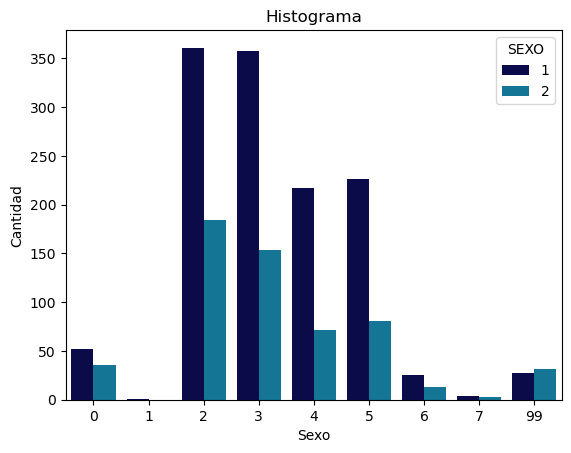

In [80]:
grafico1 = sns.countplot( x='NIVEL' ,  palette = 'ocean', data = q4,  hue='SEXO')
grafico1.set(title = 'Histograma',
           xlabel ='Sexo', ylabel = 'Cantidad')
plt.show()

In [133]:
data1 = pd.read_csv('vivienda_hogar_limpio.csv')
data1.head(5)

,Unnamed: 0,P1_1,P1_2,P1_3,P1_4,P1_5_1,P1_5_2,P1_5_3,P2_1,P2_2,...,HOGAR,P4_1_1,P4_1_2,P4_1_3,P4_1_4,P4_1_5,P4_1_6,P4_2_1,P4_2_2,P4_4
0,0,3,1,1,1,1,1,1,1,1,...,1,1,2,2,1,2,1,2,1,1
1,1,3,1,1,1,1,1,1,6,1,...,1,2,2,2,1,2,1,2,1,1
2,2,3,1,1,1,1,1,1,2,1,...,1,2,1,2,1,1,1,2,1,1
3,3,3,1,1,1,1,1,2,9,1,...,1,1,2,2,1,1,1,2,1,1
4,4,3,1,1,1,1,1,2,3,1,...,1,2,2,2,1,2,1,2,1,1
